# Analysis of Reddit sub

## Data preparation

### Connect to Reddit

In [53]:
import pandas as pd
import datetime as dt
from datetime import datetime
from pmaw import PushshiftAPI
pd.options.mode.chained_assignment = None
import seaborn as sns
from dataprep.eda import create_report
from ydata_profiling import ProfileReport


In [2]:
import praw


reddit = praw.Reddit(client_id = 'CFmuJgTqCFZds1GVjJcr_Q', 
                     client_secret = 'NHxFI6Bs6WCFiqdbQ_WfCfah_sfsRg',
                     user_agent ='imm_praw_proj')



Version 7.6.1 of praw is outdated. Version 7.7.0 was released Saturday February 25, 2023.


### Connect to Subreddit

In [3]:
subreddit = reddit.subreddit('ImmigrationCanada')

### Data Extraction - Main post

#### Extraction - Top posts

In [4]:
# Load data to dataframe
df_top = pd.DataFrame([ vars(post) for post in subreddit.top(time_filter='all', limit=1000)])


In [5]:
# Create dataframe with relevant selected columns
df_top_final = df_top[["selftext", "author_fullname", "title", "ups", "link_flair_text", "upvote_ratio", "media_embed", "created", "num_comments", "id"]]

In [6]:
df_top_final['created'] = df_top_final['created'].map(datetime.utcfromtimestamp)

In [7]:
df_top_final.head(5)

,selftext,author_fullname,title,ups,link_flair_text,upvote_ratio,media_embed,created,num_comments,id
0,"Hi guys,\n\nI've been lurking around this sub ...",t2_14v9x4,Advice from a Canadian Immigration veteran - D...,448,Express Entry,0.97,{},2020-09-27 16:06:02,67,j0tmbd
1,,t2_2lap81b8,The wait is finally over! EE FSW-O Jan 2020 AOR,428,Express Entry,1.00,{},2021-06-03 21:32:33,96,nrolek
2,Minutes ago I received an email notifying me t...,t2_y8cp6w6,I Just Became Permanent Resident,346,Other,0.96,{},2021-02-17 20:09:12,52,lm3ecw
3,,NaN,Something to rejoice :),317,Express Entry,0.97,{},2020-08-01 21:22:43,23,i203uw
4,"Too hyped, can’t sleep. Yes, it took my family...",t2_5jcfoo25,FINALLY BECOMING A PERMANENT RESIDENT AFTER 13...,312,None,0.99,{},2021-01-18 11:22:00,30,kzsuc5


#### Extraction - Posts by Year

In [8]:
# Load data using Pushift API
api = PushshiftAPI()

##### Subreddit posts 2022

In [9]:
start_epoch=dt.datetime(2022, 1, 1,0,0,0).strftime('%s')
end_epoch = dt.datetime(2022,12,31,0,0,0).strftime('%s')
gen_2022 = api.search_submissions(subreddit='ImmigrationCanada', before=end_epoch, after=start_epoch)


In [10]:
# Create DataFrame from api submissions result
post_list_2022 = [post for post in gen_2022]
df_2022 = pd.DataFrame(post_list_2022)

In [11]:
df_2022.head(5)

,subreddit,selftext,author_fullname,gilded,title,link_flair_richtext,subreddit_name_prefixed,hidden,pwls,link_flair_css_class,...,url,subreddit_subscribers,created_utc,num_crossposts,media,is_video,retrieved_utc,updated_utc,utc_datetime_str,author_cakeday
0,ImmigrationCanada,[removed],t2_540ykdmy,0,Does a fiancé in one's home country counts as ...,[],r/ImmigrationCanada,False,6,study,...,https://www.reddit.com/r/ImmigrationCanada/com...,84620,1672458056,0,None,False,1672458072,1672458072,2022-12-31 03:40:56,NaN
1,ImmigrationCanada,Can one enter canada back from trip to the US ...,t2_si97f,0,Enter Canada via USA,[],r/ImmigrationCanada,False,6,,...,https://www.reddit.com/r/ImmigrationCanada/com...,84614,1672453847,0,None,False,1672453862,1672453863,2022-12-31 02:30:47,NaN
2,ImmigrationCanada,"So, I found this job that is only full time an...",t2_rcmty5l,0,Can you get your PR if tou worked full time an...,[],r/ImmigrationCanada,False,6,citizenship,...,https://www.reddit.com/r/ImmigrationCanada/com...,84613,1672451645,0,None,False,1672451657,1672451657,2022-12-31 01:54:05,NaN
3,ImmigrationCanada,[removed],t2_81at3sju,0,I did my upfront medical exam for the PR submi...,[],r/ImmigrationCanada,False,6,ee,...,https://www.reddit.com/r/ImmigrationCanada/com...,84613,1672451125,0,None,False,1672451138,1672451138,2022-12-31 01:45:25,NaN
4,ImmigrationCanada,[removed],t2_3b2t0cd4,0,definition of nephew for sponsorship,[],r/ImmigrationCanada,False,6,sponsorship,...,https://www.reddit.com/r/ImmigrationCanada/com...,84608,1672447653,0,None,False,1672447665,1672447666,2022-12-31 00:47:33,NaN


In [12]:
df_2022.columns

Index(['subreddit', 'selftext', 'author_fullname', 'gilded', 'title',
       'link_flair_richtext', 'subreddit_name_prefixed', 'hidden', 'pwls',
       'link_flair_css_class', 'thumbnail_height', 'top_awarded_type',
       'hide_score', 'quarantine', 'link_flair_text_color', 'upvote_ratio',
       'author_flair_background_color', 'subreddit_type',
       'total_awards_received', 'media_embed', 'thumbnail_width',
       'author_flair_template_id', 'is_original_content', 'secure_media',
       'is_reddit_media_domain', 'is_meta', 'category', 'secure_media_embed',
       'link_flair_text', 'score', 'is_created_from_ads_ui', 'author_premium',
       'thumbnail', 'edited', 'author_flair_css_class',
       'author_flair_richtext', 'gildings', 'content_categories', 'is_self',
       'link_flair_type', 'wls', 'removed_by_category', 'author_flair_type',
       'domain', 'allow_live_comments', 'suggested_sort', 'view_count',
       'archived', 'no_follow', 'is_crosspostable', 'pinned', 'over_18'

In [13]:
df_2022_final = df_2022[['selftext','author_fullname','title','score','link_flair_text','upvote_ratio','media_embed','created_utc','num_comments','id']]
df_2022_final['created_utc'] = df_2022_final['created_utc'].map(datetime.utcfromtimestamp)

In [14]:
df_2022_final.head(5)

,selftext,author_fullname,title,score,link_flair_text,upvote_ratio,media_embed,created_utc,num_comments,id
0,[removed],t2_540ykdmy,Does a fiancé in one's home country counts as ...,1,Study Permit,1.0,{},2022-12-31 03:40:56,0,zzkf0w
1,Can one enter canada back from trip to the US ...,t2_si97f,Enter Canada via USA,1,Other,1.0,{},2022-12-31 02:30:47,0,zzizgc
2,"So, I found this job that is only full time an...",t2_rcmty5l,Can you get your PR if tou worked full time an...,1,Citizenship,1.0,{},2022-12-31 01:54:05,0,zzi753
3,[removed],t2_81at3sju,I did my upfront medical exam for the PR submi...,1,Express Entry,1.0,{},2022-12-31 01:45:25,0,zzi0re
4,[removed],t2_3b2t0cd4,definition of nephew for sponsorship,1,Sponsorship,1.0,{},2022-12-31 00:47:33,0,zzgr97


##### Extraction automation (2013-2023)

In [15]:
# Define years in scope
year_in_scope = list(range(2013,2024))

def data_frame(year):
    start_period = dt.datetime(year, 1,1,0,0,0).strftime('%s')
    end_period = dt.datetime(year, 12, 31, 0, 0,0).strftime('%s')
    extract = api.search_submissions(subreddit='ImmigrationCanada', before=end_period, after=start_period)
    listing = [post for post in extract]
    df = pd.DataFrame(listing)
    return df

In [16]:
dfs = []
for year in year_in_scope:
    df = data_frame(year)
    dfs.append(df)

In [17]:
df_all = pd.concat(dfs, keys=year_in_scope).reset_index()

In [18]:
df_all.columns

Index(['level_0', 'level_1', 'subreddit_id', 'author_flair_text',
       'retrieved_on', 'num_comments', 'ups', 'subreddit', 'media',
       'selftext_html',
       ...
       'awarders', 'discussion_type', 'removed_by', 'removed_by_category',
       'total_awards_received', 'treatment_tags', 'top_awarded_type',
       'upvote_ratio', 'is_created_from_ads_ui', 'view_count'],
      dtype='object', length=111)

In [19]:
df_all = df_all[['level_0','selftext','author', 'author_fullname', 'title','link_flair_text','ups','num_comments','id','media_embed','created_utc', 'upvote_ratio']]
df_all = df_all.rename(columns={'level_0':'Year'})
df_all['created_utc'] = df_all['created_utc'].map(datetime.utcfromtimestamp)

In [20]:
df_all.head(5)

,Year,selftext,author,author_fullname,title,link_flair_text,ups,num_comments,id,media_embed,created_utc,upvote_ratio
0,2013,I am Indian. I want to study in Canada and I w...,geekpirate1,NaN,Applying for Visa,None,1.0,2.0,1tusw5,{},2013-12-28 04:06:59,NaN
1,2013,"So, recently, a friend of mine worked on a doc...",[deleted],NaN,Petition to let Naim stay in Canada under refu...,None,1.0,0.0,1szl5v,{},2013-12-16 05:30:08,NaN
2,2013,I have friend from Denmark who is very interes...,BreaksFull,NaN,I have a friend looking to immigrate to Canada...,None,1.0,6.0,1ssxf6,{},2013-12-13 16:25:00,NaN
3,2013,"I recently finished my undergrad studies, and ...",modestlymousey,NaN,My bf and I are wanting to move to Vancouver i...,None,0.0,0.0,1si5k9,{},2013-12-09 23:56:26,NaN
4,2013,"I'd imagine my situation is somewhat typical, ...",CCeee,NaN,Starting Questions!,None,1.0,3.0,1scy1o,{},2013-12-08 02:25:05,NaN


#### Extraction of Controversial posts

In [21]:
# Controversial posts extraction - All time
df_mixed_all = pd.DataFrame([ vars(post) for post in subreddit.controversial(time_filter='all', limit=1000)])

In [22]:
df_mixed_all = df_mixed_all[['author_fullname','author','selftext','title','upvote_ratio','ups','link_flair_text','id','num_comments','created_utc','media_embed']]
df_mixed_all['created_utc'] = df_mixed_all['created_utc'].map(datetime.utcfromtimestamp)

In [23]:
df_mixed_all.head(5)

,author_fullname,author,selftext,title,upvote_ratio,ups,link_flair_text,id,num_comments,created_utc,media_embed
0,t2_2hky4lg1,thepeopleschoice666,I understand that this sub is intended for us ...,META: People who downvote without adding any help,0.52,5,Other,fbroi5,18,2020-03-01 09:23:15,{}
1,t2_6ngrzp8c,AngryDrago,MtF American guy here. Due to the recent laws ...,I am a transgender American. Can I apply for r...,0.45,0,Other,uibvnz,14,2022-05-04 17:30:02,{}
2,t2_3z4odiz8,wardway69,I am Syrian I have been living in limbo going ...,Sorry for the language. But fr am I fucked,0.50,0,Other,10uj639,10,2023-02-05 18:14:28,{}
3,t2_3bn5czo5,Nuzzla,"Hello, just venting really. Lived in Canada fo...",PR - Back to the start...,0.50,0,Express Entry,11mvbsj,25,2023-03-09 15:38:53,{}
4,t2_jt2sw,useunix,"I am not sure how to put it, but I am looking ...",Could anyone recommend a creative immigration ...,0.50,0,Sponsorship,chlpbf,43,2019-07-25 10:02:40,{}


In [24]:
# Controversial posts extraction - Current year
df_mixed_current = pd.DataFrame([ vars(post) for post in subreddit.controversial(time_filter='year', limit=1000)])

In [25]:
df_mixed_current = df_mixed_current[['author_fullname','author','selftext','title','upvote_ratio','ups','link_flair_text','id','num_comments','created_utc','media_embed']]
df_mixed_current['created_utc'] = df_mixed_current['created_utc'].map(datetime.utcfromtimestamp)

In [26]:
df_mixed_current.head(5)

,author_fullname,author,selftext,title,upvote_ratio,ups,link_flair_text,id,num_comments,created_utc,media_embed
0,t2_6ngrzp8c,AngryDrago,MtF American guy here. Due to the recent laws ...,I am a transgender American. Can I apply for r...,0.47,0,Other,uibvnz,14,2022-05-04 17:30:02,{}
1,t2_3z4odiz8,wardway69,I am Syrian I have been living in limbo going ...,Sorry for the language. But fr am I fucked,0.50,0,Other,10uj639,10,2023-02-05 18:14:28,{}
2,t2_3bn5czo5,Nuzzla,"Hello, just venting really. Lived in Canada fo...",PR - Back to the start...,0.50,0,Express Entry,11mvbsj,25,2023-03-09 15:38:53,{}
3,t2_djgn9d3t,RefrigeratorCrisis,"Hello peeps, i wanna move out to Canada in lik...","What do i have to do, in order tp move to cana...",0.52,1,Other,w0hi4c,13,2022-07-16 14:07:55,{}
4,t2_21dmb8r,Bunkie2315,My husband and I are needing help looking for ...,Looking to leave the US for Canada 2023-2024,0.58,11,None,vwxbs9,27,2022-07-12 00:12:33,{}


## Data Exploration

### Top posts exploration

In [39]:
# Added year column to Top posts dataframe
df_top_final['Year'] = df_top_final['created'].map(lambda x: x.year)

  0%|                                                  | 0/1339 [00:00<?, ?it/s]

DataPrep Report
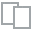
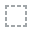
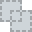
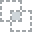
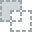
...
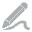
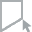
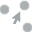
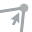
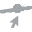

In [49]:
# Data exploration using dataprep for Top Posts 
create_report(df_top_final)

In [54]:
ProfileReport(df_top_final, title='Profile Report for Top posts')

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

### All posts from 2013 - 2023 exploration

### Controversial posts exploration